In [ ]:
#!/usr/bin/env python

import lasagne
from lasagne import layers
from lasagne.updates import nesterov_momentum
from nolearn.lasagne import NeuralNet
from nolearn.lasagne import BatchIterator
import theano

import numpy as np

import sys
import os
import gzip
import pickle
import numpy as np
import time

import cPickle as pickle

DATA_PATH = '../../../Kaggle_emotion/fer2013/fer2013.csv'

In [ ]:
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
import matplotlib.pyplot as plt

from scipy.signal import convolve2d as conv2d



Loading the data

In [ ]:
def load_data():
    	"""Get data with labels, split into training, validation and test set."""

	data = np.loadtxt(DATA_PATH, dtype=str, delimiter=',')
	(num_imgs, columns) = data.shape
	emotion = np.array([np.int32(elem) for elem in data[1:, 0]])
	img= np.array([elem.split(' ') for elem in data [1:, 1]])
	image = []
	for row in img:
    		image.append([np.float32(np.float32(elem)/255.0) for elem in row])
	image = np.array(image)
	
	train_idx, test_idx, val_idx = [], [], []
	for idx,elem in enumerate(data[1:,2]):
    		if elem == 'Training':
        		train_idx.append(idx)
    		elif elem == 'PublicTest':
        		test_idx.append(idx)
    		else:
        		val_idx.append(idx)

	X_train = image[train_idx, :]
	X_valid = image[val_idx, :]
	X_test = image[test_idx, :]
        y_train = emotion[train_idx]
        y_valid = emotion[val_idx]
        y_test = emotion[test_idx]


    	return dict(
        	X_train=X_train,
        	y_train=y_train,
        	X_valid=X_valid,
        	y_valid=y_valid,
        	X_test=X_test,
        	y_test=y_test,
        	num_examples_train=X_train.shape[0],
        	num_examples_valid=X_valid.shape[0],
        	num_examples_test=X_test.shape[0],
        	input_dim=X_train.shape[1],
        	output_dim=7,
    	)


In [ ]:
st = time.time()
print "Loading Data...."
data = load_data()
print "Data Loaded in %d sec. \nTraining..." %(time.time()-st)

emotions = ["Angry","Disgust","Fear","Happy","Sad","Surprise","Neutral"]

Flipping images for data augmentatio

In [ ]:
class FlipBatchIterator(BatchIterator):
    def transform(self, X, y):
        X, y = super(FlipBatchIterator, self).transform(X, y)

        # Flip half of the images in this batch at random:
        bs = X.shape[0]
        indices = np.random.choice(bs, bs / 2, replace=False)
        X[indices] = X[indices, ::-1]
        return X, y

In [ ]:
class AdjustVariable(object):
    def __init__(self, name, start=0.03, stop=0.001):
        self.name = name
        self.start, self.stop = start, stop
        self.ls = None

    def __call__(self, nn, train_history):
        if self.ls is None:
            self.ls = np.linspace(self.start, self.stop, nn.max_epochs)

        epoch = train_history[-1]['epoch']
        new_value = np.float32(self.ls[epoch - 1])
        getattr(nn, self.name).set_value(new_value)

In [ ]:
def nn_example9(data):
    print "Training..."
    net = NeuralNet(
      layers=[
        ('input', layers.InputLayer),
        ('conv1', layers.Conv2DLayer),
        ('pool1', layers.MaxPool2DLayer),
        ('dropout1', layers.DropoutLayer),
        ('conv2', layers.Conv2DLayer),
        ('pool2', layers.MaxPool2DLayer),
        ('dropout2', layers.DropoutLayer),
        ('conv3', layers.Conv2DLayer),
        ('pool3', layers.MaxPool2DLayer),
        ('dropout3', layers.DropoutLayer),    
        ('hidden4', layers.DenseLayer),
        ('dropout4', layers.DropoutLayer),
        ('hidden5', layers.DenseLayer),
        ('dropout5', layers.DropoutLayer),    
        ('output', layers.DenseLayer),
        ],
      input_shape=(None, 1, 48, 48),
      conv1_num_filters=32, conv1_filter_size=(5,5), pool1_pool_size=(2, 2),
      dropout1_p=0.5,  
      conv2_num_filters=64, conv2_filter_size=(5,5), pool2_pool_size=(2, 2),
      dropout2_p=0.5,  
      conv3_num_filters=128, conv3_filter_size=(5,5), pool3_pool_size=(2, 2),
      dropout3_p=0.5,  
      hidden4_num_units=1000, 
      dropout4_p=0.5,
      hidden5_num_units=1000,
      dropout5_p=0.5,
      output_num_units=7, 
      output_nonlinearity=lasagne.nonlinearities.softmax,
      
      #below line comes ONLY when doing Batch Iterations
      batch_iterator_train=FlipBatchIterator(batch_size=128),
      
      update=nesterov_momentum,
      update_learning_rate = np.float32(0.01),
      update_momentum = np.float32(0.9),
      #update_learning_rate=theano.shared(np.float32(0.03)),
      #update_momentum=theano.shared(np.float32(0.9)),
      
      #on_epoch_finished=[
      #  AdjustVariable('update_learning_rate', start=0.03, stop=0.0001),
      #  AdjustVariable('update_momentum', start=0.9, stop=0.999),
      #  ],        
      max_epochs=5,
      verbose=1,
      )
    
    
     # Train the network
    net.fit(data['X_train'].reshape(-1,1,48,48), data['y_train'])
    with open('net9.pickle', 'wb') as f:
        pickle.dump(net, f, -1)
        
        # Try the network on new data
    
    print("Feature vector (100-110): %s" % data['X_test'][0][100:110])
    print("Label: %s" % str(data['y_test'][0]))
    print("Predicted: %s" % str(net.predict([data['X_test'][0].reshape(-1,48,48)])))
    
    train_loss = np.array([i["train_loss"] for i in net.train_history_])
    #print net.train_history_
    
    #favorite_color = pickle.load( open( "net9.pickle", "rb" ) )
    return net

In [73]:
net9 = nn_example9(data)

Training...
# Neural Network with 1778031 learnable parameters

## Layer information

  #  name      size
---  --------  --------
  0  input     1x48x48
  1  conv1     32x44x44
  2  pool1     32x22x22
  3  dropout1  32x22x22
  4  conv2     64x18x18
  5  pool2     64x9x9
  6  dropout2  64x9x9
  7  conv3     128x5x5
  8  pool3     128x2x2
  9  dropout3  128x2x2
 10  hidden4   1000
 11  dropout4  1000
 12  hidden5   1000
 13  dropout5  1000
 14  output    7

  epoch    train loss    valid loss    train/val    valid acc  dur
-------  ------------  ------------  -----------  -----------  -----
      1       1.82976       1.82586      1.00214      0.25129  9.30s
      2       1.81454       1.81413      1.00023      0.25129  9.27s
      3       1.81303       1.81290      1.00007      0.25129  9.26s
      4       1.81300       1.81177      1.00068      0.25129  9.25s
      5       1.81179       1.81133      1.00026      0.25129  9.25s
Feature vector (100-110): [ 0.99215686  0.99215686  0.98039

In [81]:
net9.load_params_from(pickle.load(open('./net8.pickle', 'rb')))


Loaded parameters to layer 'conv1' (shape 32x1x5x5).
Loaded parameters to layer 'conv1' (shape 32).
Loaded parameters to layer 'conv2' (shape 64x32x5x5).
Loaded parameters to layer 'conv2' (shape 64).
Loaded parameters to layer 'conv3' (shape 128x64x5x5).
Loaded parameters to layer 'conv3' (shape 128).
Loaded parameters to layer 'hidden4' (shape 512x1000).
Loaded parameters to layer 'hidden4' (shape 1000).
Loaded parameters to layer 'hidden5' (shape 1000x1000).
Loaded parameters to layer 'hidden5' (shape 1000).
Loaded parameters to layer 'output' (shape 1000x7).
Loaded parameters to layer 'output' (shape 7).


In [ ]:
X_test_data = np.loadtxt('./X_test_Maanit_48.txt', dtype=int, delimiter=',')

In [82]:
X_test_data = np.loadtxt('./X_test_emotion.txt', dtype=int, delimiter=',')

(108, 2304)


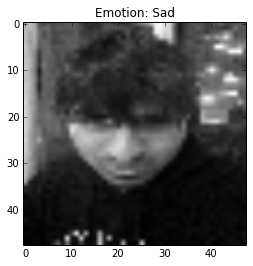

	Predicted: Sad


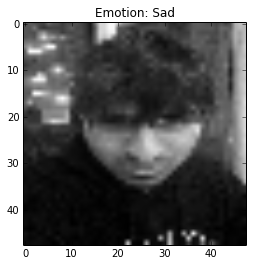

	Predicted: Sad


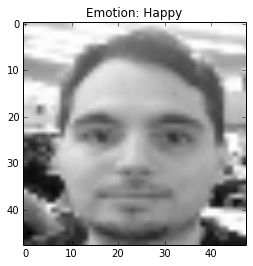

	Predicted: Happy


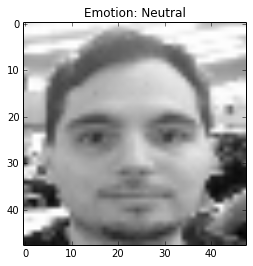

	Predicted: Neutral


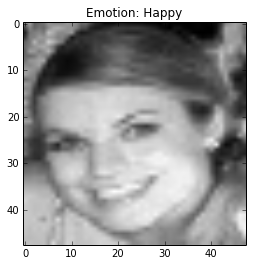

	Predicted: Happy


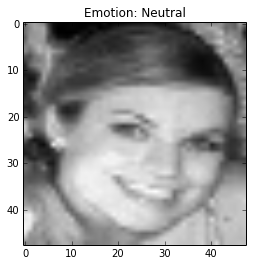

	Predicted: Neutral


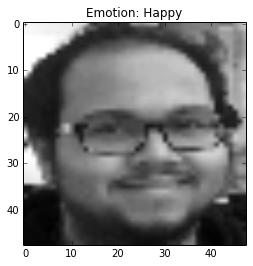

	Predicted: Happy


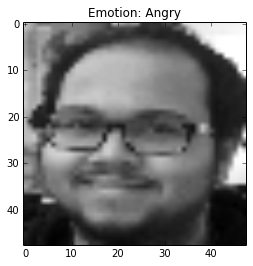

	Predicted: Angry


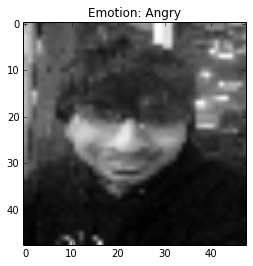

	Predicted: Angry


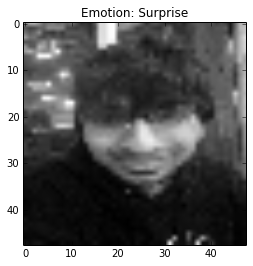

	Predicted: Surprise


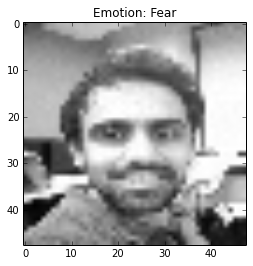

	Predicted: Fear


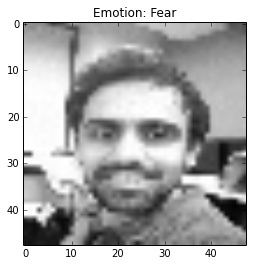

	Predicted: Fear


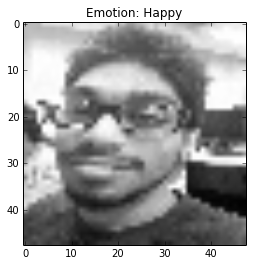

	Predicted: Happy


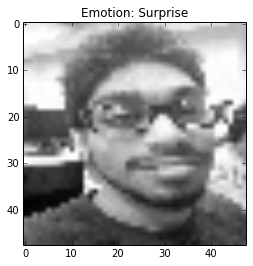

	Predicted: Surprise


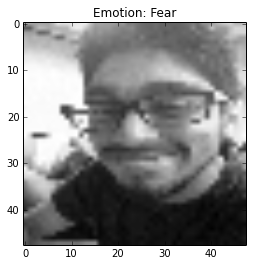

	Predicted: Fear


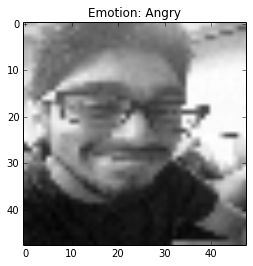

	Predicted: Angry


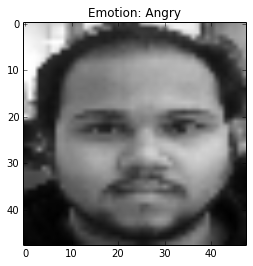

	Predicted: Angry


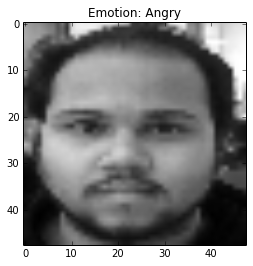

	Predicted: Angry


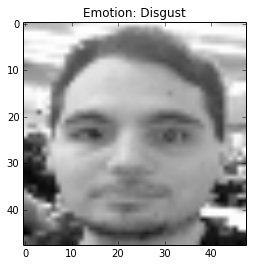

	Predicted: Disgust


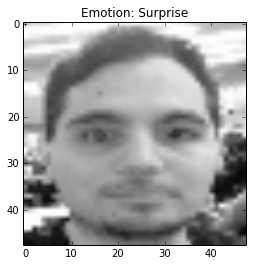

	Predicted: Surprise


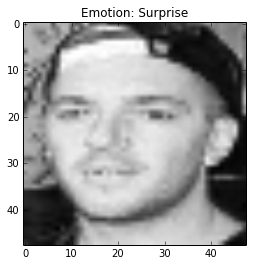

	Predicted: Surprise


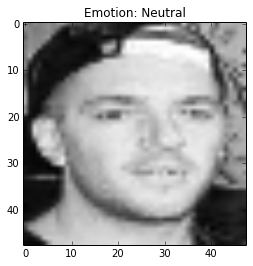

	Predicted: Neutral


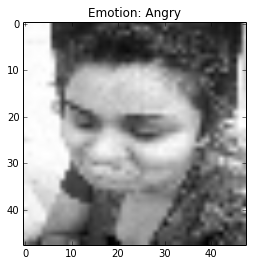

	Predicted: Angry


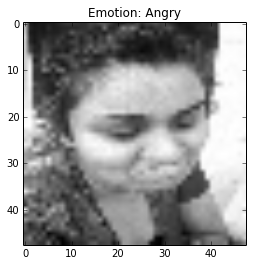

	Predicted: Angry


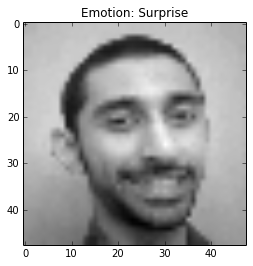

	Predicted: Surprise


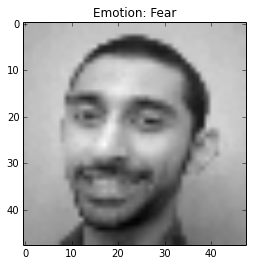

	Predicted: Fear


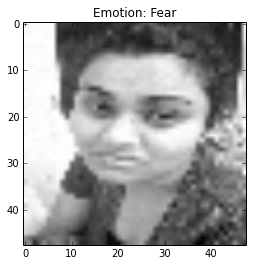

	Predicted: Fear


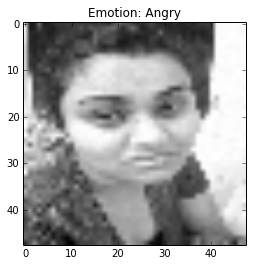

	Predicted: Angry


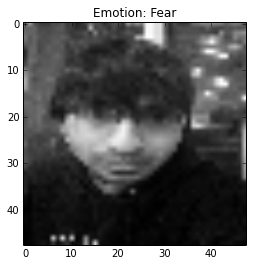

	Predicted: Fear


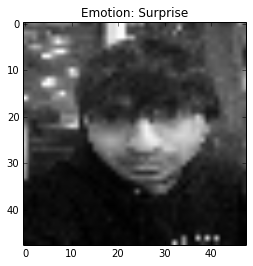

	Predicted: Surprise


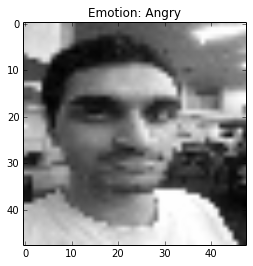

	Predicted: Angry


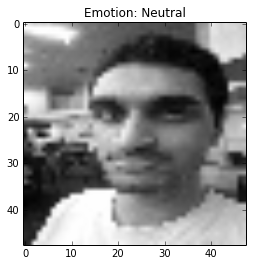

	Predicted: Neutral


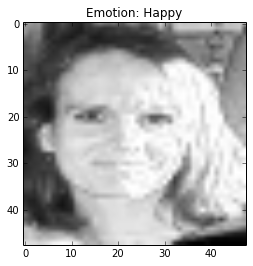

	Predicted: Happy


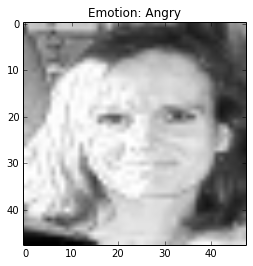

	Predicted: Angry


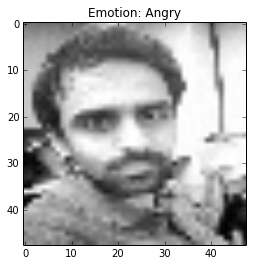

	Predicted: Angry


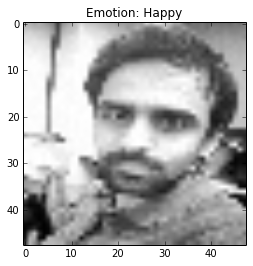

	Predicted: Happy


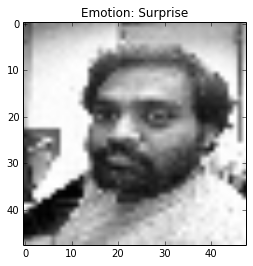

	Predicted: Surprise


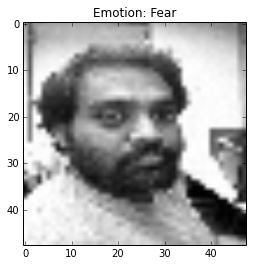

	Predicted: Fear


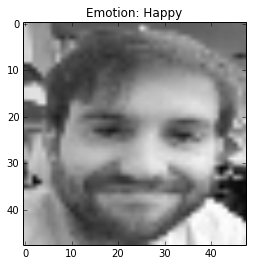

	Predicted: Happy


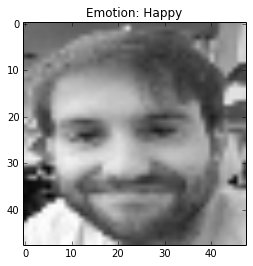

	Predicted: Happy


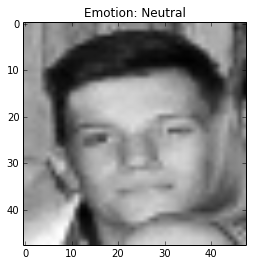

	Predicted: Neutral


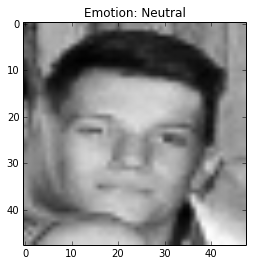

	Predicted: Neutral


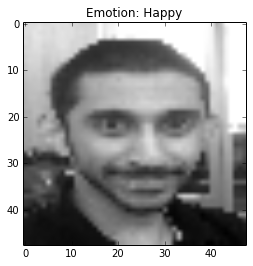

	Predicted: Happy


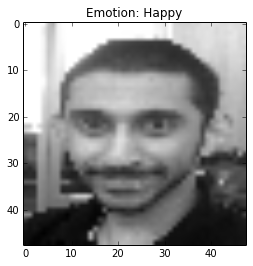

	Predicted: Happy


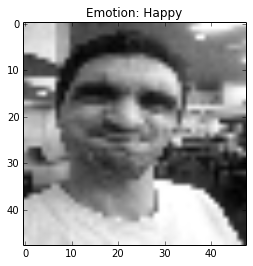

	Predicted: Happy


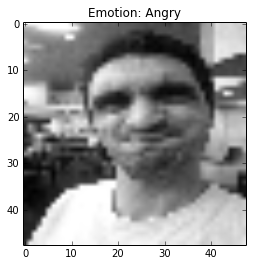

	Predicted: Angry


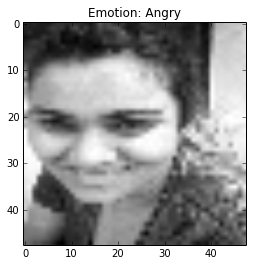

	Predicted: Angry


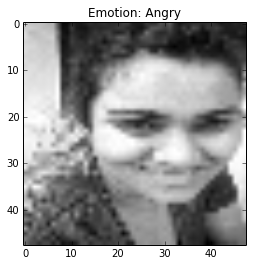

	Predicted: Angry


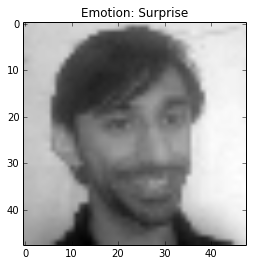

	Predicted: Surprise


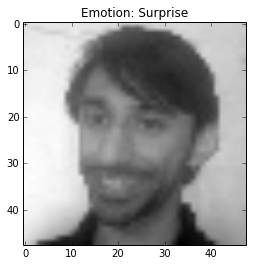

	Predicted: Surprise


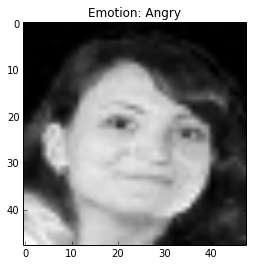

	Predicted: Angry


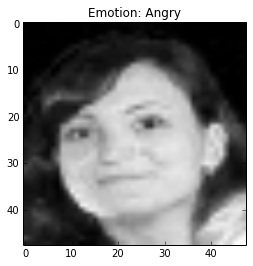

	Predicted: Angry


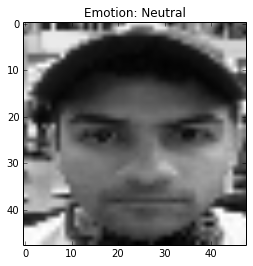

	Predicted: Neutral


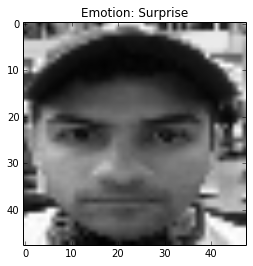

	Predicted: Surprise


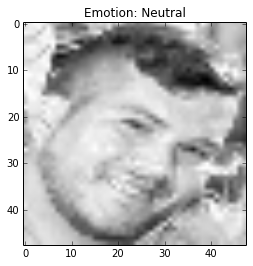

	Predicted: Neutral


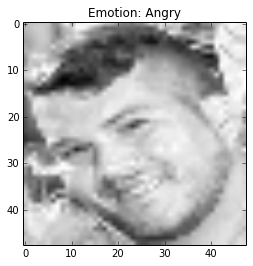

	Predicted: Angry


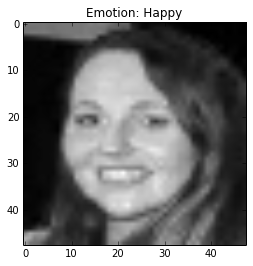

	Predicted: Happy


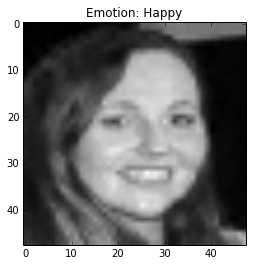

	Predicted: Happy


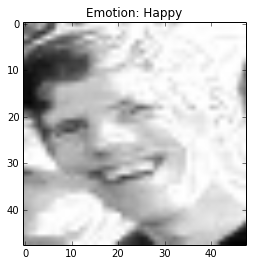

	Predicted: Happy


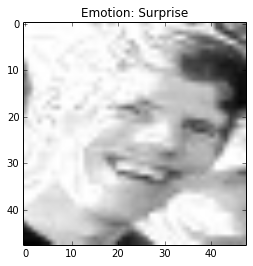

	Predicted: Surprise


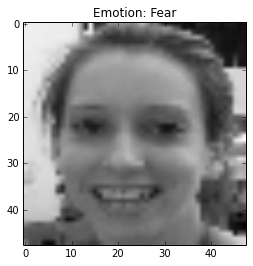

	Predicted: Fear


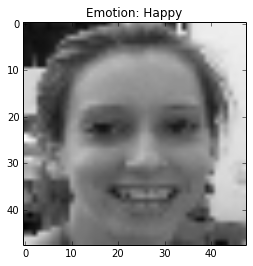

	Predicted: Happy


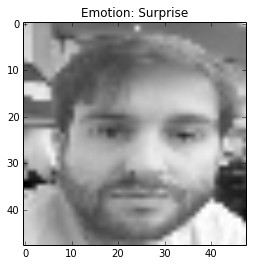

	Predicted: Surprise


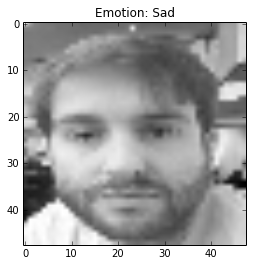

	Predicted: Sad


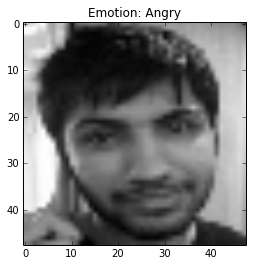

	Predicted: Angry


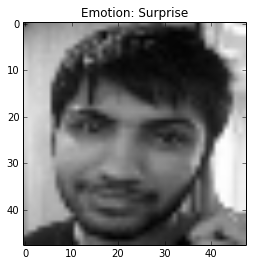

	Predicted: Surprise


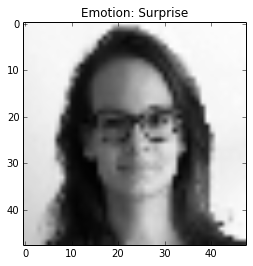

	Predicted: Surprise


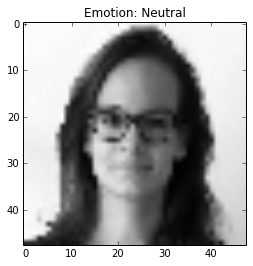

	Predicted: Neutral


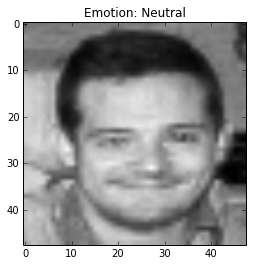

	Predicted: Neutral


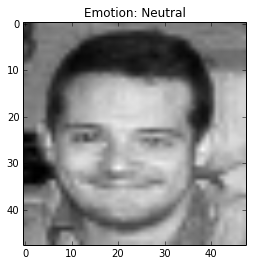

	Predicted: Neutral


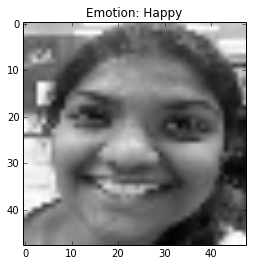

	Predicted: Happy


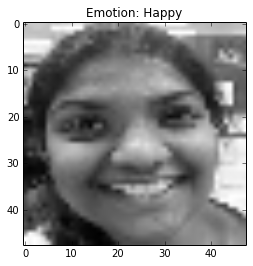

	Predicted: Happy


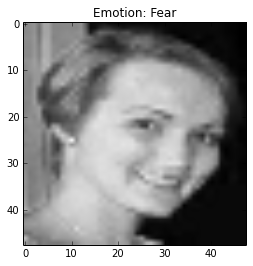

	Predicted: Fear


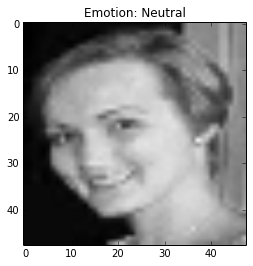

	Predicted: Neutral


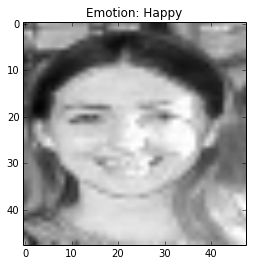

	Predicted: Happy


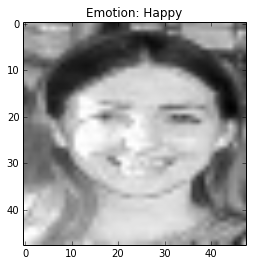

	Predicted: Happy


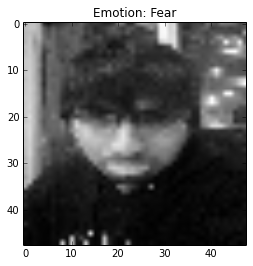

	Predicted: Fear


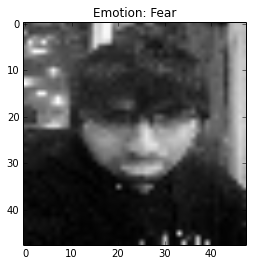

	Predicted: Fear


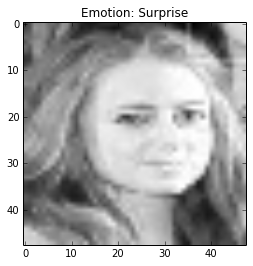

	Predicted: Surprise


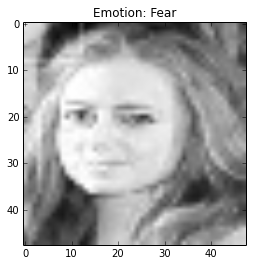

	Predicted: Fear


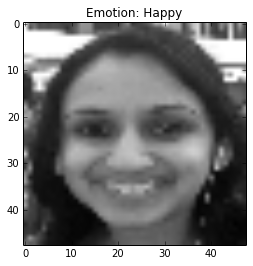

	Predicted: Happy


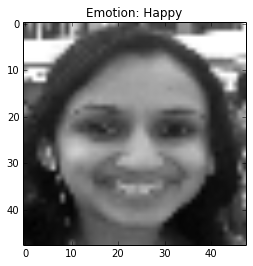

	Predicted: Happy


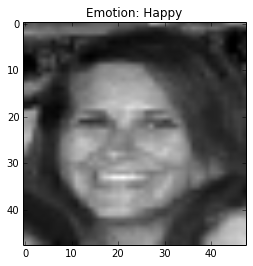

	Predicted: Happy


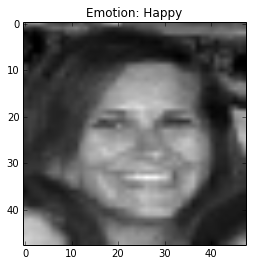

	Predicted: Happy


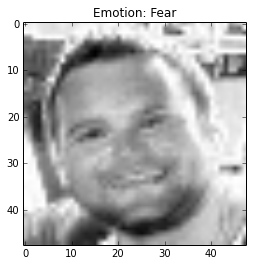

	Predicted: Fear


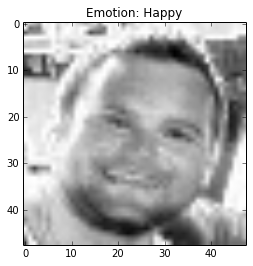

	Predicted: Happy


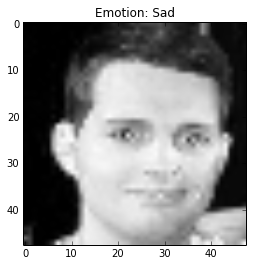

	Predicted: Sad


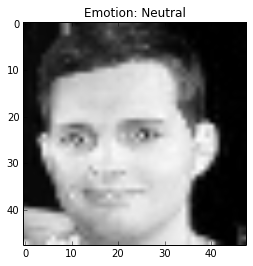

	Predicted: Neutral


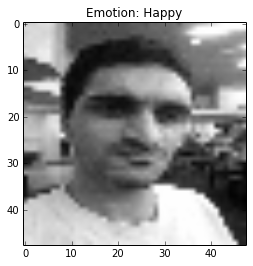

	Predicted: Happy


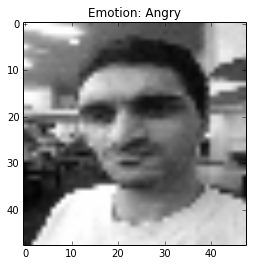

	Predicted: Angry


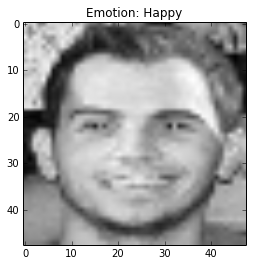

	Predicted: Happy


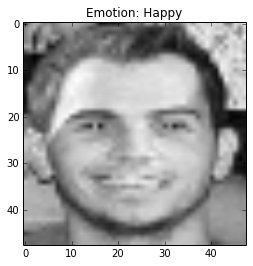

	Predicted: Happy


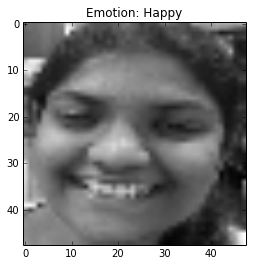

	Predicted: Happy


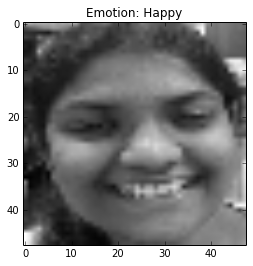

	Predicted: Happy


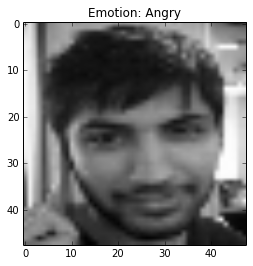

	Predicted: Angry


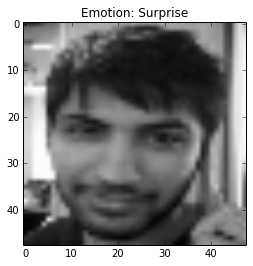

	Predicted: Surprise


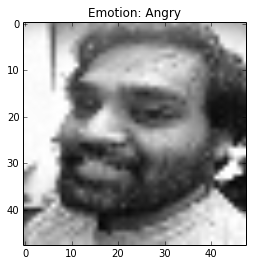

	Predicted: Angry


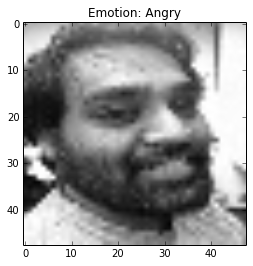

	Predicted: Angry


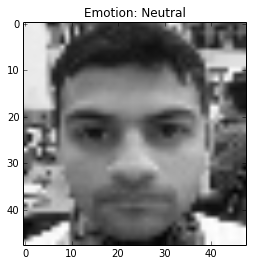

	Predicted: Neutral


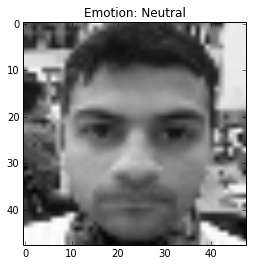

	Predicted: Neutral


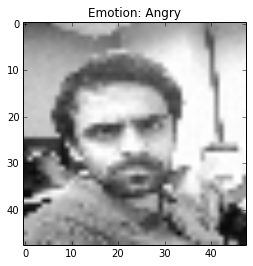

	Predicted: Angry


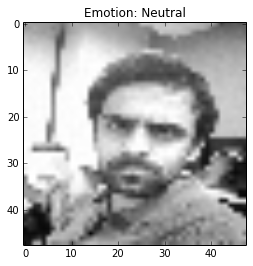

	Predicted: Neutral


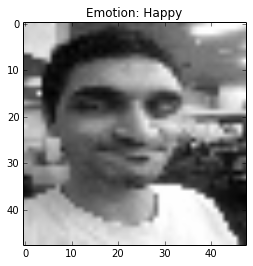

	Predicted: Happy


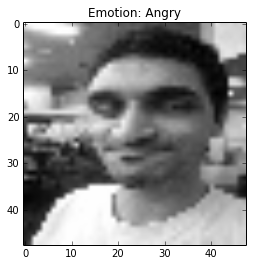

	Predicted: Angry


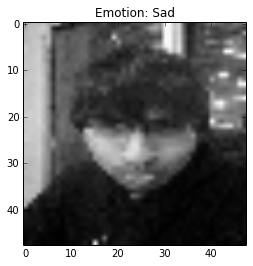

	Predicted: Sad


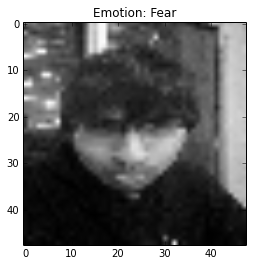

	Predicted: Fear


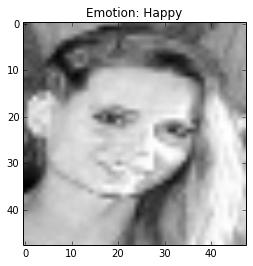

	Predicted: Happy


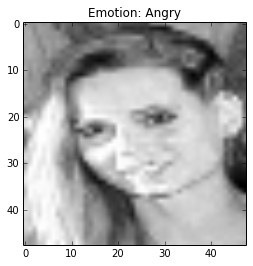

	Predicted: Angry


In [83]:
X_test_fin = X_test_data

print X_test_data.shape
for idx,elem in enumerate(X_test_fin):
    #print elem.shape
    res = emotions[np.uint32 (net9.predict([elem.reshape(-1,48,48)]))]
    if np.random.rand() > 0.0:
        plt.clf()
        plt.title("Emotion: %s"%res)
        plt.imshow(elem.reshape(48,48), cmap='gray')
        plt.show()
    print( "\tPredicted: %s" %res )

In [ ]:
'''
X_test_fin = np.array([row.reshape(48,48).T.reshape(48*48,) for row in X_test_data])

print X_test_data.shape
for idx,elem in enumerate(X_test_fin):
    #print elem.shape
    res = emotions[np.uint32 (net9.predict([elem.reshape(-1,48,48)]))]
    if np.random.rand() > 0.0:
        plt.clf()
        plt.title("Emotion: %s"%res)
        plt.imshow(elem.reshape(48,48), cmap='gray')
        plt.show()
    print( "\tPredicted: %s" %res )
'''

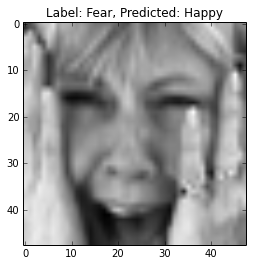

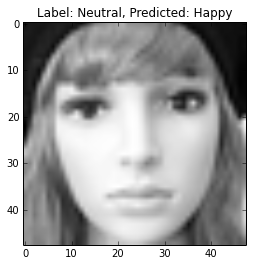

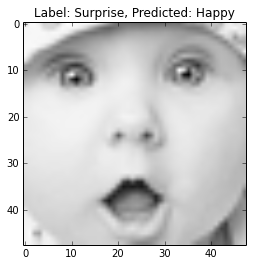

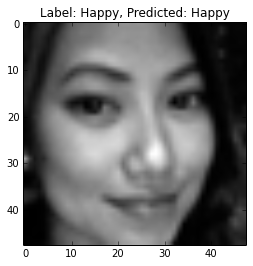

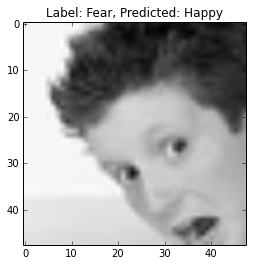

...

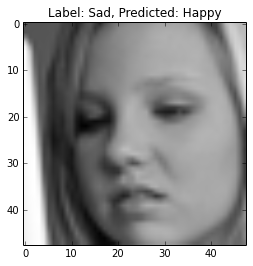

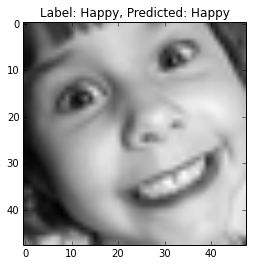

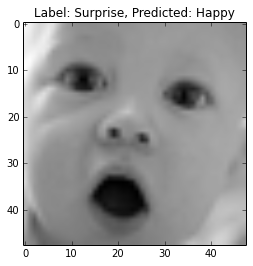

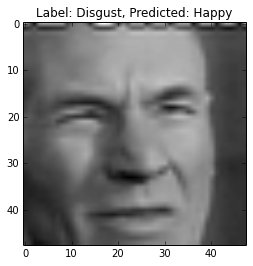

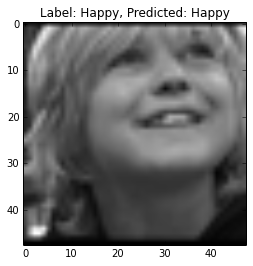

In [74]:
for idx,elem in enumerate(data['y_test']):
    #print elem.shape
    res = emotions[np.uint32 (net9.predict([data['X_test'][idx].reshape(-1,48,48)]))]
    if np.random.rand() > 0.8:
        plt.clf()
        plt.title("Label: %s, " % emotions[np.uint32(elem)] + "Predicted: %s" %res )
        plt.imshow(data['X_test'][idx].reshape(48,48), cmap='gray')
        plt.show()
        

In [ ]:
params = net9.get_all_params_values()

Plotting conv1 output


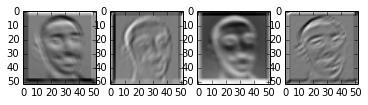

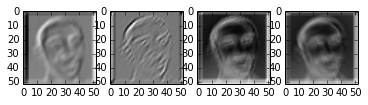

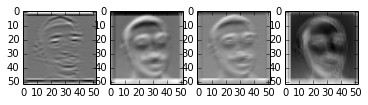

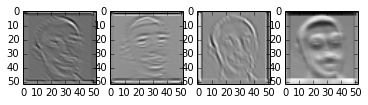

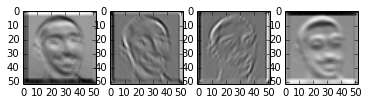

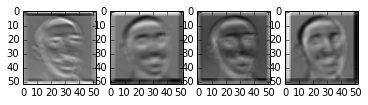

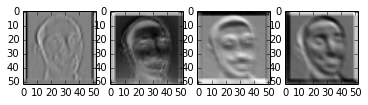

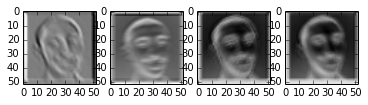

In [72]:
im = np.loadtxt('X_test_emotion.txt', dtype=int, delimiter=',')[24,:]
#print im.shape
def conv_op (name, filters):
    l = len(filters[0])
    num_col = 4
    num_row = l/num_col
    print "Plotting %s output" %name
    for i in range(num_row):
        plt.clf()
        for j in range(num_col):
            plt.subplot(1,num_col, j)
            f = filters[0][i*num_col + j][0]
            #print f.shape
            tim = conv2d(f, im.reshape(48,48))
            plt.imshow(tim, cmap='gray')
        plt.show()
        
conv_op('conv1', params['conv1'])




In [ ]:
print l

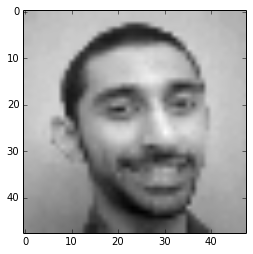

In [84]:
plt.imshow(im.reshape(48,48),cmap='gray')
plt.show()
